In [2]:
from importlib import reload
from IPython.core.interactiveshell import InteractiveShell
%load_ext autoreload
InteractiveShell.ast_node_interactivity = "all"
import logging
logging.basicConfig(level=logging.DEBUG, format='%(asctime)s - %(name)s - %(levelname)s - %(message)s')

In [3]:
import pandas as pd
import numpy as np
import os
import sys

module_path = os.path.abspath(os.path.join(".."))
if module_path not in sys.path:
    sys.path.append(module_path)

2024-07-25 16:01:15,040 - numexpr.utils - INFO - Note: NumExpr detected 32 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
2024-07-25 16:01:15,041 - numexpr.utils - INFO - NumExpr defaulting to 8 threads.


# Load Data

In [1]:
from utils.config import get_cfg_defaults
from utils.singleton_swaps_optimization import swaps_optimization_cfg
import sparse

config_path = "/cmnfs/proj/ORIGINS/SWAPS_exp/mixture/accurate_mass_mzdigits_1_20180809_120min_200ms_WEHI25_brute20k_timsON_100ng_HYE124B_Slot1-8_1_895_20240725_081238_212922/config_20240725_081238_212922.yaml"
cfg = get_cfg_defaults(swaps_optimization_cfg)
cfg.merge_from_file(config_path)
maxquant_result_ref = pd.read_pickle(cfg.DICT_PICKLE_PATH)

mobility_values_df = pd.read_csv(os.path.join(cfg.RESULT_PATH, "mobility_values.csv"))
ms1scans = pd.read_csv(os.path.join(cfg.RESULT_PATH, "ms1scans.csv"))

ModuleNotFoundError: No module named 'utils'

In [5]:
pept_act_sum_df = pd.read_csv(
    os.path.join(cfg.RESULT_PATH, "results", "activation", "pept_act_sum.csv"),
    # index_col=0,
)
pept_act_sum_filter_by_im_df = pd.read_csv(
    os.path.join(
        cfg.RESULT_PATH, "results", "activation", "pept_act_sum_filter_by_im.csv"
    ),
    # index_col=0,
)

In [6]:
act_3d = sparse.load_npz(
    os.path.join(
        cfg.RESULT_PATH, "results", "activation", "im_rt_pept_act_coo_peptbatch0.npz"
    )
)

# Intensity Correlation

## Filter Ion Mobility range

In [14]:
%autoreload 2
import importlib
import utils
importlib.reload(utils)
from utils.ims_utils import sum_3d_act_filter_by_im_fast
pept_act_sum_df = sum_3d_act_filter_by_im_fast(act_3d, maxquant_result_ref.loc[0:100], chunk_size = 200)

#pept_act_sum_df.to_csv(os.path.join(cfg.RESULT_PATH,"results","activation", "pept_act_sum_df_filtered_by_im.csv"), index=False)

<module 'utils' from '/cmnfs/proj/ORIGINS/protMSD/maxquant/ScanByScan/utils/__init__.py'>

/cmnfs/proj/ORIGINS/protMSD/maxquant/ScanByScan/utils/ims_utils.py:245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  )
/cmnfs/proj/ORIGINS/protMSD/maxquant/ScanByScan/utils/ims_utils.py:253: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  maxquant_result_ref["mobility_values_index_start"],
/cmnfs/proj/ORIGINS/protMSD/maxquant/ScanByScan/utils/ims_utils.py:263: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

S

In [12]:
pept_act_sum_df.to_csv(
    os.path.join(
        cfg.RESULT_PATH, "results", "activation", "pept_act_sum_df_filtered_by_im.csv"
    ),
    index=False,
)

In [77]:
act_dir = os.path.join(cfg.RESULT_PATH, "results", "activation")
pept_act_sum_df = pd.read_csv(
    os.path.join(act_dir, "pept_act_sum_df_filtered_by_im.csv")
)

2024-07-15 10:09:10,635 - root - INFO - Experiment data not given, using reference intensity as experiment data!


## Intensity correlation

In [7]:
if cfg.RESULT_ANALYSIS.MQ_EXP_PATH == "":
    maxquant_result_exp = maxquant_result_ref
    logging.info(
        "Experiment data not given, using reference intensity as experiment data!"
    )
elif cfg.RESULT_ANALYSIS.MQ_EXP_PATH[-4:] == ".txt":
    maxquant_result_exp = pd.read_csv(cfg.RESULT_ANALYSIS.MQ_EXP_PATH, sep="\t")
elif cfg.RESULT_ANALYSIS.MQ_EXP_PATH[-4:] == ".pkl":
    maxquant_result_exp = pd.read_pickle(cfg.RESULT_ANALYSIS.MQ_EXP_PATH)
elif cfg.RESULT_ANALYSIS.MQ_EXP_PATH[-4:] == ".csv":
    maxquant_result_exp = pd.read_csv(cfg.RESULT_ANALYSIS.MQ_EXP_PATH)

2024-07-25 10:45:36,745 - root - INFO - Experiment data not given, using reference intensity as experiment data!


In [9]:
%autoreload 2
from result_analysis import result_analysis

eval_dir = os.path.join(cfg.RESULT_PATH, "results", "evaluation")
os.makedirs(eval_dir, exist_ok=True)
if "predicted_RT" not in maxquant_result_ref.columns:
    maxquant_result_ref["predicted_RT"] = maxquant_result_ref["RT_search_center"]

sbs_result = result_analysis.SBSResult(
    maxquant_ref_df=maxquant_result_ref,
    # maxquant_merge_df=maxquant_result_exp,
    maxquant_exp_df=maxquant_result_exp,
    filter_by_rt_ovelap=cfg.RESULT_ANALYSIS.FILTER_BY_RT_OVERLAP,
    pept_act_sum_df_list=[pept_act_sum_df, pept_act_sum_filter_by_im_df],
    ims=True,
    save_dir=eval_dir,
    other_cols=['Proteins', 'Leading proteins', 'Protein group IDs']
)
for col in sbs_result.sum_cols:
    if col != "mz_rank":
        sbs_result.plot_intensity_corr(
            ref_col="Intensity", inf_col=col, contour=False, 
            #group_by="Protein group IDs",
            save_dir=None, 
            interactive = True, hover_data = ['Modified sequence', 'Charge', 'mz_rank']
        )

# # Overlap with MQ
#sbs_result.plot_overlap_with_MQ(show_ref=True)

2024-07-25 10:46:12,607 - result_analysis.result_analysis - DEBUG - Pept activation sum columns: Index(['pept_act_sum', 'mz_rank'], dtype='object')
2024-07-25 10:46:12,609 - result_analysis.result_analysis - DEBUG - Pept activation sum columns: Index(['pept_act_sum_filter_by_im', 'mz_rank'], dtype='object')
2024-07-25 10:46:12,635 - result_analysis.result_analysis - INFO - Reference shape: (34745, 113)
2024-07-25 10:46:12,730 - result_analysis.result_analysis - DEBUG - Reference shape after merging activation sum: (34745, 115)
2024-07-25 10:46:12,731 - result_analysis.result_analysis - DEBUG - Ref df mz_rank columns: (34745,)
2024-07-25 10:46:12,785 - result_analysis.result_analysis - DEBUG - Experiment shape: (34745, 113)
2024-07-25 10:46:12,944 - result_analysis.compare_maxquant - INFO - Experiment data: removing 0 entries with aggregation over PCM, 34745 entries left.
/cmnfs/proj/ORIGINS/protMSD/maxquant/ScanByScan/result_analysis/compare_maxquant.py:67: FutureWarning: Passing a set

Data:  Intensity_log pept_act_sum_log , slope =  0.531 , intercept =  0.96 , PearsonR =  0.701 , SpearmanR =  0.673


In [13]:
col = "pept_act_sum_filter_by_im"
sbs_result.plot_intensity_corr(
    ref_col="Intensity",
    inf_col=col,
    contour=False,
    # group_by="Protein group IDs",
    save_dir=None,
    interactive=True,
    hover_data=["Modified sequence", "Charge", "mz_rank"],
)

2024-07-25 10:48:45,111 - result_analysis.result_analysis - INFO - No grouping, show precurosr level correlation
2024-07-25 10:48:45,112 - result_analysis.result_analysis - DEBUG - Ref exp inner shape (34688, 25)


Data:  Intensity_log pept_act_sum_filter_by_im_log , slope =  0.888 , intercept =  -1.167 , PearsonR =  0.78 , SpearmanR =  0.782


# Protein quant: Direct LFQ

## prepare input

In [89]:
# prepare maxquant evidence.txt


protein_quant_dir = "/cmnfs/proj/ORIGINS/SWAPS_exp/mixture/new_MQ_MQ_protein_quant/"
os.makedirs(protein_quant_dir, exist_ok=True)
evidence_new_mq_search = pd.read_csv(
    "/cmnfs/data/proteomics/timstof_hela_fractionation/combined/txt/evidence.txt",
    sep="\t",
)
samplemap = evidence_new_mq_search[["Raw file", "Experiment"]].drop_duplicates()
samplemap.rename(
    columns={"Raw file": "sample", "Experiment": "condition"}, inplace=True
)
samplemap.to_csv(
    os.path.join(protein_quant_dir, "samplemap.tsv"),
    sep="\t",
    index=False,
)
evidence_new_mq_search["Experiment"] = evidence_new_mq_search["Raw file"]
evidence_new_mq_search.to_csv(
    os.path.join(protein_quant_dir, "evidence.txt"), sep="\t", index=False
)
protein_group = (
    "/cmnfs/data/proteomics/timstof_hela_fractionation/combined/txt/proteinGroups.txt"
)

/cmnfs/home/z.xiao/miniconda3/envs/sbs/lib/python3.10/site-packages/pandas/io/parsers/c_parser_wrapper.py:373: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common_type = np.find_common_type(
/tmp/ipykernel_2053844/1506983871.py:6: DtypeWarning: Columns (70) have mixed types. Specify dtype option on import or set low_memory=False.
  evidence_new_mq_search = pd.read_csv("/cmnfs/data/proteomics/timstof_hela_fractionation/combined/txt/evidence.txt", sep = "\t")


In [45]:
# prepare maxquant evidence.txt


protein_quant_dir = (
    "/cmnfs/proj/ORIGINS/SWAPS_exp/mixture/ori_MQ_MQ_matching_protein_quant/"
)
os.makedirs(protein_quant_dir, exist_ok=True)
evidence_new_mq_search = pd.read_csv(
    "/cmnfs/data/proteomics/timstof_hela_fractionation/Tenzer.matching_MaxQuant.txt/txt/evidence.txt",
    sep="\t",
)
samplemap = evidence_new_mq_search[["Raw file", "Experiment"]].drop_duplicates()
samplemap.rename(
    columns={"Raw file": "sample", "Experiment": "condition"}, inplace=True
)
samplemap.to_csv(
    os.path.join(protein_quant_dir, "samplemap.tsv"),
    sep="\t",
    index=False,
)
evidence_new_mq_search["Experiment"] = evidence_new_mq_search["Raw file"]
evidence_new_mq_search.to_csv(
    os.path.join(protein_quant_dir, "evidence.txt"), sep="\t", index=False
)
protein_group = "/cmnfs/data/proteomics/timstof_hela_fractionation/Tenzer.matching_MaxQuant.txt/txt/proteinGroups.txt"

/cmnfs/home/z.xiao/miniconda3/envs/sbs/lib/python3.10/site-packages/pandas/io/parsers/c_parser_wrapper.py:373: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common_type = np.find_common_type(
/tmp/ipykernel_2053844/2644155721.py:6: DtypeWarning: Columns (60,69) have mixed types. Specify dtype option on import or set low_memory=False.
  evidence_new_mq_search = pd.read_csv("/cmnfs/data/proteomics/timstof_hela_fractionation/Tenzer.matching_MaxQuant.txt/txt/evidence.txt", sep = "\t")


In [12]:
result_paths = [
    "/cmnfs/proj/ORIGINS/SWAPS_exp/mixture/" + dir
    for dir in [
        "new_MQ_20180809_120min_200ms_WEHI25_brute20k_timsON_100ng_HYE124A_Slot1-7_1_891_20240723_122028_635017",
        "new_MQ_20180809_120min_200ms_WEHI25_brute20k_timsON_100ng_HYE124B_Slot1-8_1_895_20240723_115335_194919",
        "new_MQ_20180809_120min_200ms_WEHI25_brute20k_timsON_100ng_HYE124A_Slot1-7_1_892_20240723_115411_010178",
    ]
]
evidence_swaps_int = pd.DataFrame()
for dir in result_paths:
    maxquant_result_ref = pd.read_pickle(os.path.join(dir, "maxquant_result_ref.pkl"))
    maxquant_result_ref = maxquant_result_ref.sort_values("mz_rank")
    pept_act_sum_filter_by_im_df = pd.read_csv(
        os.path.join(dir, "results", "activation", "pept_act_sum_filter_by_im.csv")
    )
    pept_act_sum_filter_by_im_df = pept_act_sum_filter_by_im_df.loc[1:]
    maxquant_result_ref["Intensity"] = pept_act_sum_filter_by_im_df[
        "pept_act_sum_filter_by_im"
    ].values
    evidence_swaps_int = pd.concat([evidence_swaps_int, maxquant_result_ref], axis=0)
    logging.info("evidence_swaps_int shape: %s", evidence_swaps_int.shape)

2024-07-23 15:08:40,435 - root - INFO - evidence_swaps_int shape: (41237, 113)
2024-07-23 15:08:41,515 - root - INFO - evidence_swaps_int shape: (75945, 113)
2024-07-23 15:08:42,389 - root - INFO - evidence_swaps_int shape: (113745, 113)


In [73]:
protein_quant_dir = "/cmnfs/proj/ORIGINS/SWAPS_exp/mixture/new_MQ_SWAP_protein_quant/"
os.makedirs(protein_quant_dir, exist_ok=True)
protein_group = (
    "/cmnfs/data/proteomics/timstof_hela_fractionation/combined/txt/proteinGroups.txt"
)

In [13]:
samplemap = evidence_swaps_int[["Raw file", "Experiment"]].drop_duplicates()
samplemap.rename(
    columns={"Raw file": "sample", "Experiment": "condition"}, inplace=True
)
samplemap.to_csv(
    os.path.join(protein_quant_dir, "samplemap.tsv"),
    sep="\t",
    index=False,
)

In [8]:
evidence_swaps_int["Experiment"] = evidence_swaps_int["Raw file"]
evidence_swaps_int.to_csv(
    os.path.join(protein_quant_dir, "evidence_swaps_int.txt"),
    sep="\t",
    index=False,
)

## Benchmark Direct LFQ result

In [75]:
import directlfq.benchmarking as lfqbenchmark
import directlfq.utils as lfqutils

samplemap_directlfq = os.path.join(protein_quant_dir, "samplemap.tsv")
directlfq_file = os.path.join(
    protein_quant_dir,
    "evidence_swaps_int.txt.protgroup_annotated.tsv.maxquant_evidence.protein_intensities.tsv",
)
samplemap_df_directlfq = lfqutils.load_samplemap(samplemap_directlfq)
samples_used_directlfq = lfqutils.get_samples_used_from_samplemap_df(
    samplemap_df_directlfq, cond1="HYE124A", cond2="HYE124B"
)

restable_directlfq = lfqbenchmark.ResultsTableDirectLFQ(
    input_file=directlfq_file,
    input_name="directLFQ",
    samples_c1=samples_used_directlfq[0],
    samples_c2=samples_used_directlfq[1],
)

/cmnfs/home/z.xiao/miniconda3/envs/sbs/lib/python3.10/site-packages/directlfq/benchmarking.py:153: RuntimeWarning: divide by zero encountered in log2
  self.formated_dataframe[self.log2fc_column] = [np.log2(x[0]) - np.log2(x[1]) for x in zip(self.formated_dataframe['median_intensity_c1'], self.formated_dataframe['median_intensity_c2'])]


In [49]:
ori_mq_search = pd.read_csv(
    protein_group,
    sep="\t",
)
ori_mq_search["Species"] = ori_mq_search["Fasta headers"].apply(
    lambda x: (
        "Homo sapien"
        if isinstance(x, str) and "HUMAN" in x
        else (
            "Yeast"
            if isinstance(x, str) and "YEAST" in x
            else ("Ecoli" if isinstance(x, str) and "ECOLI" in x else "")
        )
    )
)
ori_mq_search.to_csv(protein_group[:-4] + "_add_species.txt", sep="\t", index=False)
# species_merged_table = pd.merge(
#     left=restable_directlfq.formated_dataframe,
#     right=ori_mq_search[["Protein IDs", "Species"]],
#     how="left",
# )
protein_group = protein_group[:-4] + "_add_species.txt"

In [81]:
organism_annotator = lfqbenchmark.OrganismAnnotatorMaxQuant(
    mapping_file=protein_group, protein_column="Protein IDs"
)

organism_annotator.annotate_table_with_organism(restable_directlfq)

ValueError: Usecols do not match columns, columns expected but not found: ['Species']

In [77]:
display(restable_directlfq.formated_dataframe)

,protein,20180809_120min_200ms_WEHI25_brute20k_timsON_100ng_HYE124A_Slot1-7_1_891,20180809_120min_200ms_WEHI25_brute20k_timsON_100ng_HYE124A_Slot1-7_1_892,20180809_120min_200ms_WEHI25_brute20k_timsON_100ng_HYE124B_Slot1-8_1_895,Gene names,Protein IDs,median_intensity_c1,median_intensity_c2,log2fc,mean_intensity,organism
0,A0A087WVF4;O14646;O14646-2;A0A994J7K7;O14647;A...,75447.158731,89139.556412,82995.099056,CHD1;CHD2,A0A087WVF4;O14646;O14646-2;A0A994J7K7;O14647;A...,82293.357572,82995.099056,-0.012250,82644.228314,Homo sapiens
1,A0A087WXD2;A0A087WT53;Q96QZ7;Q96QZ7-3;H7C5T8;H...,26908.552332,20201.610424,18135.531942,MAGI1,A0A087WXD2;A0A087WT53;Q96QZ7;Q96QZ7-3;H7C5T8;H...,23555.081378,18135.531942,0.377219,20845.306660,Homo sapiens
2,A0A087WZ13;Q8IY67-2;Q8IY67;K7EKR9;Q8IY67-3;K7EQG2,368305.254589,363048.353854,346473.896223,RAVER1,A0A087WZ13;Q8IY67-2;Q8IY67;K7EKR9;Q8IY67-3;K7EQG2,365676.804221,346473.896223,0.077822,356075.350222,Homo sapiens
3,A0A087X0N3;Q96MY1;Q96MY1-2;Q5W149,11828.103500,13768.929313,5109.298770,NOL4L,A0A087X0N3;Q96MY1;Q96MY1-2;Q5W149,12798.516407,5109.298770,1.324779,8953.907588,Homo sapiens
4,A0A0A6YYL4;P57737-3;P57737;P57737-4;P57737-2;I...,125958.153464,140168.894693,150951.217781,PAM16;CORO7;CORO7-PAM16,A0A0A6YYL4;P57737-3;P57737;P57737-4;P57737-2;I...,133063.524079,150951.217781,-0.181967,142007.370930,Homo sapiens
...,...,...,...,...,...,...,...,...,...,...,...
5818,R4GNH3;E9PN50,437033.818001,403625.633877,393955.919078,PSMC3,R4GNH3;E9PN50,420329.725939,393955.919078,0.093487,407142.822508,Homo sapiens
5819,S4R359,7724.469236,8172.734143,9130.651978,HNRNPK,S4R359,7948.601690,9130.651978,-0.200017,8539.626834,Homo sapiens
5820,S4R3H4;Q9UKV3;Q9UKV3-5;E7EQT4;Q9UKV3-2;G3V3B0;...,396467.007182,357610.319175,356038.631868,ACIN1,S4R3H4;Q9UKV3;Q9UKV3-5;E7EQT4;Q9UKV3-2;G3V3B0;...,377038.663178,356038.631868,0.082679,366538.647523,Homo sapiens
5821,S4R3N1;Q9Y3A3;Q9Y3A3-2;Q9Y3A3-3;B4DM50,54532.826982,54267.307557,53778.749514,HSPE1;HSPE1-MOB4,S4R3N1;Q9Y3A3;Q9Y3A3-2;Q9Y3A3-3;B4DM50,54400.067269,53778.749514,0.016572,54089.408392,Homo sapiens


In [78]:
restable_directlfq.formated_dataframe["organism"].value_counts()

Homo sapiens                3964
Saccharomyces cerevisiae    1611
Escherichia coli             248
Name: organism, dtype: int64

In [79]:
restable_directlfq.formated_dataframe["organism"].unique()

array(['Homo sapiens', 'Saccharomyces cerevisiae', 'Escherichia coli'],
      dtype=object)

Homo sapiens num:3761 median_FC:-0.069 STD:0.59

Saccharomyces cerevisiae num:1120 median_FC:0.46 STD:0.6

Escherichia coli num:245 median_FC:-1.4 STD:0.77



/cmnfs/home/z.xiao/miniconda3/envs/sbs/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/cmnfs/home/z.xiao/miniconda3/envs/sbs/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])


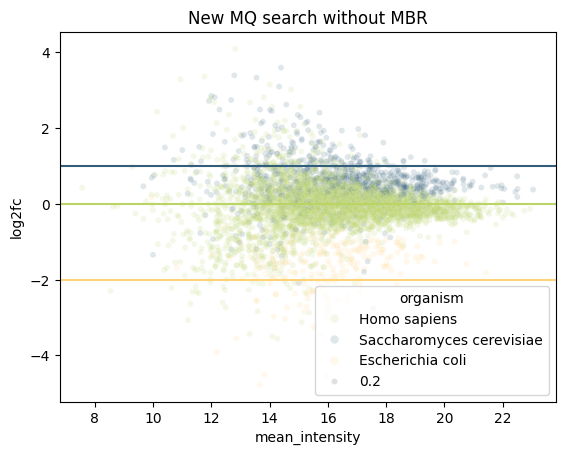

In [80]:
import matplotlib.pyplot as plt
import pandas as pd
import directlfq.visualizations as lfq_viz
import directlfq.benchmarking as lfq_benchmark
import numpy as np

fig, axes = plt.subplots(1, 1)  # , gridspec_kw={'width_ratios' : [1, 1, 1]})


fcplotter_directLFQ = lfqbenchmark.MultiOrganismIntensityFCPlotter(
    ax=axes,
    resultstable_w_ratios=restable_directlfq,
    organisms_to_plot=["Homo sapiens", "Saccharomyces cerevisiae", "Escherichia coli"],
    # organisms_to_plot=["Homo sapien", "Yeast", "Ecoli"],
    fcs_to_expect=[0, np.log2(2), -np.log2(4)],
    title="New MQ search without MBR",
)
fig.savefig(os.path.join(protein_quant_dir, "FC_plot.png"), dpi=300)

In [23]:
sbs_result.plot_intensity_corr(
    ref_col="Intensity",
    inf_col="pept_act_sum",
    contour=False,
    save_dir=None,
    interactive=True,
    hover_data=["mz_rank"],
)

2024-07-12 15:53:55,138 - result_analysis.result_analysis - INFO - No grouping, show precurosr level correlation
2024-07-12 15:53:55,139 - result_analysis.result_analysis - DEBUG - Ref exp inner shape (38191, 23)


Data:  Intensity_log pept_act_sum_log , slope =  0.498 , intercept =  2.207 , PearsonR =  0.671 , SpearmanR =  0.649


ValueError: The truth value of a DataFrame is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

# Exam individual peptide image

In [25]:
maxquant_result_exp.loc[16263, ["1/K0", "Calibrated 1/K0"]],

(1/K0               0.930669
 Calibrated 1/K0    0.930669
 Name: 16263, dtype: object,)

2024-07-25 10:56:07,903 - utils.plot - INFO - Dictionary entry            Modified sequence  Charge      1/K0  RT_search_left  \
16263  _MGDFGSIHRPGIVVDYQNK_       3  0.930669          47.237   

       RT_search_right  RT_search_center  Retention time  \
16263           47.473            47.375          47.375   

       Number of data points  Number of scans  
16263                    427               13  
2024-07-25 10:56:07,911 - utils.plot - INFO - Experiment result:            Modified sequence  Charge  Calibrated retention time start  \
16263  _MGDFGSIHRPGIVVDYQNK_       3                           47.237   

       Calibrated retention time finish      1/K0  1/K0 length  \
16263                            47.473  0.930669     0.136143   

       Number of data points  Retention length  
16263                    427            0.2362  , bounding box available: [47.237, 47.473, 0.2359999999999971, 0.862597795, 0.998740405, 0.13614261]
2024-07-25 10:56:07,920 - postprocessing.ims

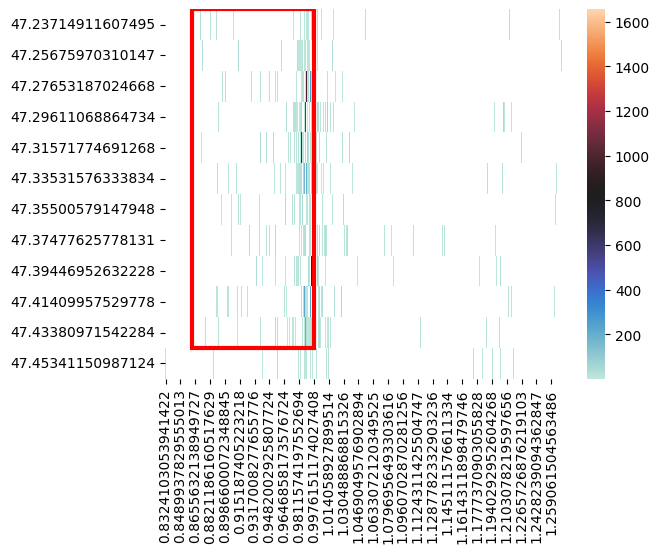

In [18]:
%autoreload 2
from utils.plot import plot_pept_im_rt_heatmap

plot_pept_im_rt_heatmap(
    pept_mz_rank=17897,
    act_3d=act_3d,
    maxquant_result_dict=maxquant_result_ref,
    maxquant_result_exp=maxquant_result_exp,
    mobility_values_df=mobility_values_df,
    ms1scans=ms1scans,
    log_intensity=False
)

In [ ]:
import importlib

importlib.reload(result_analysis)
from result_analysis import result_analysis

pept_act_sum_df = pd.read_csv(
    os.path.join(cfg.RESULT_PATH, "results", "activation", "pept_act_sum.csv")
)
pept_act_sum_df["mz_rank"] = pept_act_sum_df.index
eval_dir = os.path.join(cfg.RESULT_PATH, "results", "evaluation")
os.makedirs(eval_dir, exist_ok=True)
if "predicted_RT" not in maxquant_result_ref.columns:
    maxquant_result_ref["predicted_RT"] = maxquant_result_ref["RT_search_center"]

sbs_result = result_analysis.SBSResult(
    maxquant_ref_df=maxquant_result_ref,
    # maxquant_merge_df=maxquant_result_ref,
    maxquant_exp_df=maxquant_result_ref,
    filter_by_rt_ovelap=["full_overlap"],
    sum_raw=pept_act_sum_df,
    ims=True,
)

sbs_result.plot_intensity_corr(
    ref_col="Intensity",
    inf_col="pept_act_sum",
    contour=False,
    # group_by="Leading razor protein"
    save_dir=eval_dir,
)

# Overlap with MQ
sbs_result.plot_overlap_with_MQ(save_dir=eval_dir, show_ref=True)

2024-04-03 16:14:08,032 - result_analysis.result_analysis - INFO - Reference shape: (36743, 81)
2024-04-03 16:14:08,091 - result_analysis.result_analysis - DEBUG - sum cols: ['mz_rank', 'sum_raw']
2024-04-03 16:14:08,227 - result_analysis.compare_maxquant - DEBUG - Maxquant experiment file has 37448 entries.
2024-04-03 16:14:08,228 - result_analysis.compare_maxquant - DEBUG - columns after merge MQ dict and MQ exp Index(['Modified sequence', 'Charge', 'predicted_RT', 'm/z', 'Mass', 'Length',
       'id', 'RT_search_left', 'RT_search_right',
       'Calibrated retention time start', 'Calibrated retention time finish',
       'Calibrated retention time', 'Retention time', 'Intensity', '_merge'],
      dtype='object')
2024-04-03 16:14:08,909 - result_analysis.compare_maxquant - INFO - RT overlap counts: full_overlap       37544
partial_overlap     3863
no_overlap          1994
Name: RT_overlap, dtype: int64


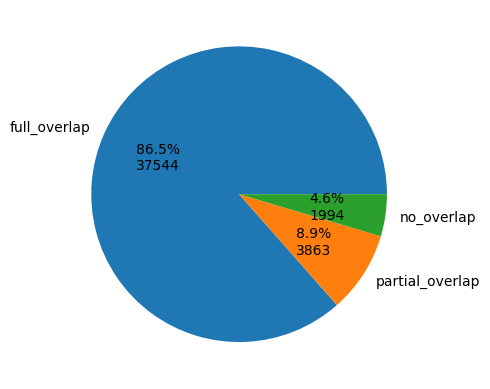

2024-04-03 16:14:09,218 - result_analysis.result_analysis - INFO - No filter_by_rt_overlap is specified, use all entries for plotting.
2024-04-03 16:14:09,265 - result_analysis.compare_maxquant - INFO - Removing 8250 entries with aggregation over PCM, 35151 entries left.
2024-04-03 16:14:09,266 - result_analysis.compare_maxquant - DEBUG - columns after agg Index(['Modified sequence', 'Charge', 'Calibrated retention time start',
       'Calibrated retention time finish', 'Calibrated retention time',
       'Retention time', 'Intensity', 'id', 'Mass', 'm/z', 'Length'],
      dtype='object')
2024-04-03 16:14:09,296 - result_analysis.result_analysis - INFO - Ref exp inner join shape: (36743, 14)


In [171]:
%autoreload 2
from result_analysis.result_analysis import SBSResult
sbs_ims_result = SBSResult(
    maxquant_ref_df=maxquant_result_dict,
    maxquant_exp_df=maxquant_result_exp,
    sum_raw=sum_raw,
    #sum_gaussian = auc_raw,
    ims=True,
)
sbs_ims_result.compare_with_maxquant_exp_int(
    filter_by_rt_overlap=None, save_dir=None)


Data:  Intensity_log sum_raw_log , slope =  0.68 , intercept =  0.672 , PearsonR =  0.696 , SpearmanR =  0.752


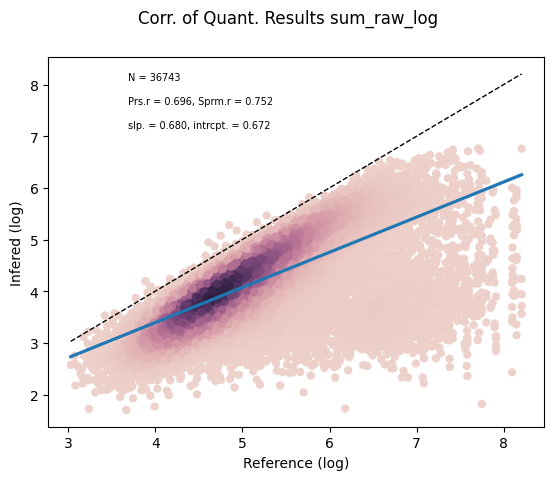

In [172]:
sbs_ims_result.plot_intensity_corr(
    inf_col="sum_raw",
    interactive=False,
    save_dir=None,
    contour=False,
    log_x=True,
    log_y=True,
    hover_data=["mz_rank", "Modified sequence", "Charge"],
    # color=SBS_ss1FDR_PSM.ref_exp_df_inner["Length"],
)

2024-04-03 14:22:07,287 - utils.plot - DEBUG - RT search range: [12.949009017446059, 14.74900901744606]
2024-04-03 14:22:07,288 - utils.plot - DEBUG - mod_seq: _SLYQSAGVAPESFEYIEAHGTGTK_, charge: 3
2024-04-03 14:22:07,293 - utils.plot - DEBUG - RT exp range [array([13.554]), array([13.711])]


,Time_minute,raw,Scan index
0,12.964942,173.522305,NaN
1,12.984647,0.000000,NaN
2,13.004381,11.773809,NaN
3,13.023998,0.000000,NaN
4,13.043576,77.589440,NaN
...,...,...,...
86,14.656036,123.473891,NaN
87,14.675634,0.000000,NaN
88,14.695496,0.000000,NaN
89,14.715132,0.000000,NaN


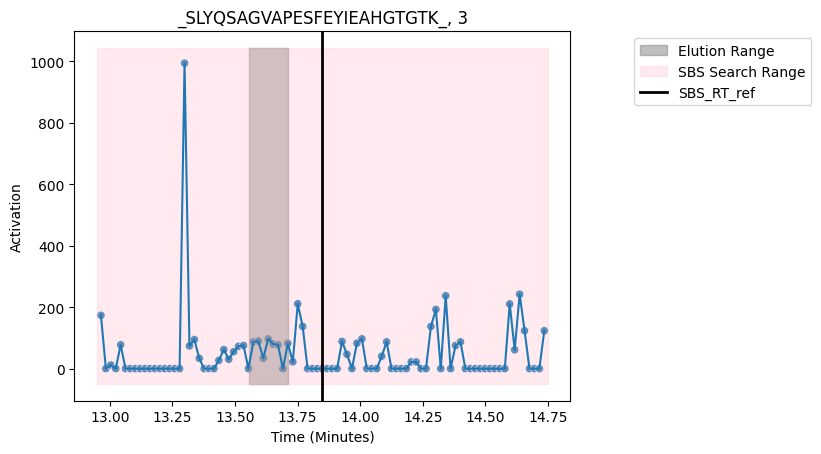

In [135]:
from utils.plot import plot_activation

activation = activation.fillna(0)
pept_idx = 178243
plot_activation(
    maxquant_ref_row=maxquant_result_dict.loc[
        maxquant_result_dict["mz_rank"] == pept_idx, :
    ],
    maxquant_exp_df=maxquant_result_exp,
    precursor_activations=[activation.loc[:, pept_idx]],
    activation_labels=["raw"],
    ms1scan_no_array=ms1scans.loc[activation.index.values],
    ms1scan_time_col="Time_minute",
)

In [5]:
# Make result directory
report_dir = os.path.join(result_dir, "report")
if not os.path.exists(report_dir):
    os.makedirs(report_dir)
    os.makedirs(os.path.join(report_dir, "activation"))

# Statistics

# Batch Correlation and Report

### Precursor specific trouble shooting

In [6]:
# Load MS1 scans from pkl or mzml file
msconvert_file = (  # path to the data input in mzML format, containing only MS1 level data
    "/mnt/cmnfs/proj/ORIGINs/protMSD/GCF_profile/msconvert_profile.mzML"
)
with open(msconvert_file[:-5] + ".pkl", "rb") as f:
    MS1Scans = pickle.load(f)

In [27]:
from optimization.dictionary import CalcModpeptIsopattern

Maxquant_result_dict["IsoMZ"], Maxquant_result_dict["IsoAbundance"] = zip(
    *Maxquant_result_dict.apply(
        lambda row: CalcModpeptIsopattern(
            modpept=row["Modified sequence"], charge=row["Charge"], ab_thres=0.001
        ),
        axis=1,
    )
)

<module 'utility' from '/mnt/cmnfs/proj/ORIGINS/protMSD/maxquant/ScanByScan/utility.py'>

Precursor  18083 eluted at  76.242 , corresponding scan index  3829 with scan time  76.2416156238556


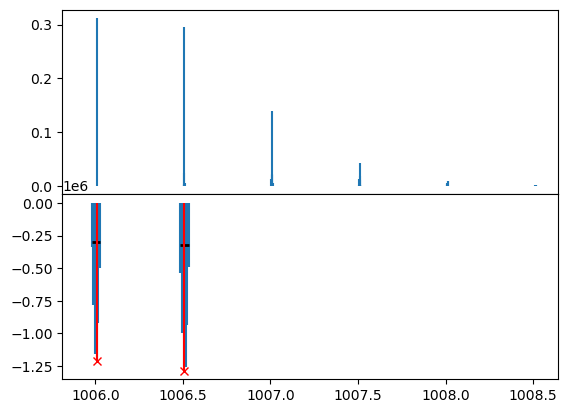

,apex_mzidx,apex_mz,start_mzidx,start_mz,end_mzidx,end_mz,peak_width,peak_height,peak_intensity_sum
0,7,1006.007087,4,1005.978361,9,1006.026239,0.047878,302067.40625,4.906113e+06
1,20,1006.505206,18,1006.486040,23,1006.533955,0.047914,321781.87500,5.505740e+06


In [28]:
from result_analysis.result_analysis import PlotIsoPatternAndScan

PlotIsoPatternAndScan(
    MS1Scans=MS1Scans,
    Maxquant_result=Maxquant_result_dict,
    scan_idx=None,
    precursor_idx=18083,
    log_intensity=False,
)

<module 'utility' from '/mnt/cmnfs/proj/ORIGINS/protMSD/maxquant/ScanByScan/utility.py'>

Cosine distance of non zero entries in prediction: 0.00980649186033511
Intensity Explained: 0.0434
Peaks Explained: 0.4591


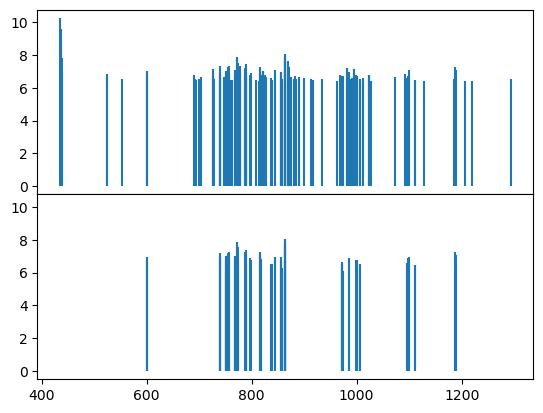

In [29]:
from optimization.dictionary import ConstructDict
from result_analysis.result_analysis import PlotTrueAndPredict

alignment = []
scan_idx = 3830
RT_tol = 1
alpha = 10
# example: generate dictionary for candidate in one scan
OneScan = MS1Scans.iloc[scan_idx, :]
CandidatePrecursorsByRT = Maxquant_result_dict.loc[
    (
        Maxquant_result_dict["Calibrated retention time start"] - RT_tol
        <= OneScan["starttime"]
    )
    & (
        Maxquant_result_dict["Calibrated retention time finish"] + RT_tol
        >= OneScan["starttime"]
    )
]
if CandidatePrecursorsByRT.shape[0] > 0:
    (
        CandidateDict,
        CandidatePrecursorsByRT,
        alignment,
        IsotopeNotObs,
        y_true,
        peak_results,
    ) = ConstructDict(CandidatePrecursorsByRT, OneScan, method="peakRange")
    filteredPrecursorIdx = np.array(CandidateDict.columns[0:], dtype=int)
    if CandidateDict.shape[1] > 1:
        (
            activationByScan,
            lossByScan,
            scoreByScan,
            pred,
            IntensityExplained,
            peaksExplained,
        ) = utility.CalcPrecursorQuant(
            CandidateDict,
            y_true,
            filteredPrecursorIdx=filteredPrecursorIdx,
            alpha=alpha,
        )
        activation[filteredPrecursorIdx, scan_idx] = activationByScan
        # non_empty_scans.append((scan_idx, OneScan['starttime'], lossByScan, scoreByScan, CandidatePrecursorsByRT.index, filteredPrecursorIdx))
        # ScanProcessRecords[scan_idx] = {'alignment':alignment}
        PlotTrueAndPredict(
            x=CandidateDict.index, prediction=pred, true=y_true["intensity"], log=True
        )
        print("Cosine distance of non zero entries in prediction:", scoreByScan)
        print("Intensity Explained:", np.round(IntensityExplained, 4))
        print("Peaks Explained:", np.round(peaksExplained, 4))
    else:
        print(
            "Scan number, start time ",
            scan_idx,
            OneScan["starttime"],
            "does not have valid candidate.",
        )
        # empty_scans.append((scan_idx, OneScan['starttime'], 'No valid candidate after isotope pattern matching.'))

else:
    print(
        "Scan number, start time ",
        scan_idx,
        OneScan["starttime"],
        "does not have valid candidate.",
    )
    # empty_scans.append((scan_idx, OneScan['starttime'], 'No valid candidate by RT'))

In [30]:
alignment[303]["abundance"].sum()
IsotopeNotObs[303]["abundance"].sum()

0.5232761444636144

0.4490588887347563

In [32]:
Maxquant_result_dict.loc[11557, "IsoAbundance"].sum()

0.9723350331983707

In [33]:
idx = np.where(filteredPrecursorIdx == 18082)
activationByScan[idx]

array([9769022.28253018])

In [17]:
import IsoSpecPy as iso

pair = [18083, 18082]
Maxquant_result_dict.loc[
    pair, ["Modified sequence", "Charge", "Retention time", "Intensity", "m/z"]
]
iso.ParseFASTA(Maxquant_result_dict.loc[pair[0], "Modified sequence"])
iso.ParseFASTA(Maxquant_result_dict.loc[pair[1], "Modified sequence"])

,Modified sequence,Charge,Retention time,Intensity,m/z
18083,_VNQIGTLTETFEAIEM(ox)AK_,2,76.242,27290000.0,1006.00626
18082,_VNQIGTLTETFEAIEM(ox)AK_,2,75.905,NaN,1006.00626


OrderedDict([('C', 99), ('H', 162), ('N', 24), ('O', 32), ('S', 1)])

OrderedDict([('C', 99), ('H', 162), ('N', 24), ('O', 32), ('S', 1)])

In [122]:
import IsoSpecPy as iso

Maxquant_result_dict.loc[
    [738, 10695], ["Modified sequence", "Charge", "Retention time", "Intensity", "m/z"]
]
iso.ParseFASTA(Maxquant_result_dict.loc[738, "Modified sequence"])
iso.ParseFASTA(Maxquant_result_dict.loc[10695, "Modified sequence"])

,Modified sequence,Charge,Retention time,Intensity,m/z
738,_AISVDELQK_,2,21.921,26158000.0,501.776939
10695,_LGLENVETK_,2,21.921,26158000.0,501.776939


OrderedDict([('C', 43), ('H', 73), ('N', 11), ('O', 15), ('S', 0)])

OrderedDict([('C', 43), ('H', 73), ('N', 11), ('O', 15), ('S', 0)])

In [121]:
pair = [15879, 12747]
Maxquant_result_dict.loc[
    pair, ["Modified sequence", "Charge", "Retention time", "Intensity", "m/z"]
]
iso.ParseFASTA(Maxquant_result_dict.loc[pair[0], "Modified sequence"])
iso.ParseFASTA(Maxquant_result_dict.loc[pair[1], "Modified sequence"])

,Modified sequence,Charge,Retention time,Intensity,m/z
15879,_TDLINAVAEASSLSK_,2,70.373,20798000.0,759.904128
12747,_NIFSDPLTIEEIK_,2,70.373,20798000.0,759.906139


OrderedDict([('C', 64), ('H', 109), ('N', 17), ('O', 24), ('S', 0)])

OrderedDict([('C', 69), ('H', 109), ('N', 15), ('O', 22), ('S', 0)])

In [127]:
pair = [3772, 3774]
Maxquant_result_dict.loc[
    pair, ["Modified sequence", "Charge", "Retention time", "Intensity", "m/z"]
]
iso.ParseFASTA(Maxquant_result_dict.loc[pair[0], "Modified sequence"])
iso.ParseFASTA(Maxquant_result_dict.loc[pair[1], "Modified sequence"])

,Modified sequence,Charge,Retention time,Intensity,m/z
3772,_EHGAVFIIGIGDALR_,3,62.458,7362600.0,523.291219
3774,_EHGAVFIIGIGDALR_,3,62.330,NaN,523.291219


OrderedDict([('C', 71), ('H', 112), ('N', 20), ('O', 19), ('S', 0)])

OrderedDict([('C', 71), ('H', 112), ('N', 20), ('O', 19), ('S', 0)])

In [128]:
pair = [15120, 14965]
Maxquant_result_dict.loc[
    pair, ["Modified sequence", "Charge", "Retention time", "Intensity", "m/z"]
]
iso.ParseFASTA(Maxquant_result_dict.loc[pair[0], "Modified sequence"])
iso.ParseFASTA(Maxquant_result_dict.loc[pair[1], "Modified sequence"])

,Modified sequence,Charge,Retention time,Intensity,m/z
15120,_SLAEQNVILCFASGR_,2,62.377,8509700.0,832.924871
14965,_SIAAFAIHQFFQER_,2,62.060,NaN,832.930814


OrderedDict([('C', 69), ('H', 112), ('N', 20), ('O', 21), ('S', 1)])

OrderedDict([('C', 78), ('H', 111), ('N', 21), ('O', 19), ('S', 0)])

In [129]:
for idx in [738, 10695] + [15120, 14965] + [3772, 3774] + [15879, 12747]:
    _ = postprocessing.post_processing.PlotActivation(
        MaxquantEntry=Maxquant_result_dict.iloc[idx, :],
        PrecursorTimeProfiles=[
            activation[idx, :],
            refit_activation_minima[idx, :],
            refit_activation_gaussian[idx, :],
        ],
        PrecursorTimeProfileLabels=["None", "LocalMinima", "Gaussian"],
        MS1ScansNoArrary=MS1Scans_NoArray,
        save_dir=os.path.join(report_dir, "activation", "outliers"),
    )